In [1]:
from typing import List, Optional
from tqdm import tqdm

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
import scipy.stats as st
from scipy.stats import probplot, ks_2samp

from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold, cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.utils.validation import check_is_fitted
import missingno as msno
import xgboost as xgb
%matplotlib inline

/home/bocharick/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
# train = pd.read_csv("data/house-prices-advanced-regression-techniques/train.csv")
train = pd.read_csv("data/train.csv")
# test = pd.read_csv("data/house-prices-advanced-regression-techniques/test.csv")
test = pd.read_csv("data/test.csv")

print("train.shape = {} rows, {} cols".format(*train.shape))
print("test.shape = {} rows, {} cols".format(*test.shape))

train.shape = 200000 rows, 202 cols
test.shape = 200000 rows, 201 cols


In [3]:
train_columns = ["var_0", "var_1", "var_2", "var_5", "var_9", "var_10", "var_13", "var_20", "var_26", "var_40", "var_55", "var_80", "var_106", "var_109", "var_139", "var_175", "var_184", "var_196", "target"]
test_columns = ["var_0", "var_1", "var_2", "var_5", "var_9", "var_10", "var_13", "var_20", "var_26", "var_40", "var_55", "var_80", "var_106", "var_109", "var_139", "var_175", "var_184", "var_196"]

In [4]:
train = train[train_columns]

In [5]:
test = test[test_columns]

In [6]:
train.describe()

,var_0,var_1,var_2,var_5,var_9,var_10,var_13,var_20,var_26,var_40,var_55,var_80,var_106,var_109,var_139,var_175,var_184,var_196,target
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,10.679914,-1.627622,10.715192,-5.065317,7.567236,0.394340,8.530232,13.290894,-4.055133,-6.725505,12.745852,5.795044,8.617657,18.458001,7.760193,11.640613,12.756676,2.303335,0.100490
std,3.040051,4.050044,2.640894,7.863267,1.235070,5.500793,4.639536,5.876254,5.922210,8.279259,5.690072,7.436737,1.894899,4.355031,7.686433,2.892167,9.318280,5.454369,0.300653
min,0.408400,-15.043400,2.117100,-32.562600,3.970500,-20.731300,-6.011100,-5.432200,-24.243100,-35.211700,-3.782600,-18.042200,0.942400,5.769700,-21.274300,3.241500,-18.489700,-14.209600,0.000000
25%,8.453850,-4.740025,8.722475,-11.200350,6.618800,-3.594950,5.072800,8.627800,-8.321725,-12.831825,8.163900,0.694475,7.282300,15.107175,2.387575,9.371600,5.663300,-1.946925,0.000000
50%,10.524750,-1.608050,10.580000,-4.833150,7.629600,0.487300,8.604250,13.196800,-4.196900,-6.617450,12.594100,6.061750,8.605150,18.281350,8.066250,11.679800,12.521000,2.408900,0.000000
75%,12.758200,1.358625,12.516700,0.924800,8.584425,4.382925,12.274775,17.879400,-0.090200,-0.880875,17.086625,11.449125,9.928900,21.852900,13.232525,13.745500,19.456150,6.556725,0.000000
max,20.315000,10.376800,19.353000,17.251600,11.150600,18.670200,22.331500,31.285900,15.675100,18.105600,29.092100,30.476900,15.307400,32.059100,36.097100,20.854800,44.363400,18.321500,1.000000


In [7]:
train.head()

,var_0,var_1,var_2,var_5,var_9,var_10,var_13,var_20,var_26,var_40,var_55,var_80,var_106,var_109,var_139,var_175,var_184,var_196,target
0,8.9255,-6.7863,11.9081,-9.2834,5.7470,2.9252,0.5745,10.5350,-5.1488,-5.2387,14.8322,13.6468,9.5426,24.3627,15.6599,7.7423,25.8398,7.8784,0
1,11.5006,-4.1473,13.8588,7.0433,8.0851,-0.4032,8.4135,3.4287,-11.7684,-11.1147,18.5995,2.5462,7.3412,13.0858,16.1622,10.4968,22.5441,8.1267,0
2,8.6093,-2.7457,12.0805,-9.0837,5.9525,-0.3249,7.3124,17.7559,-7.9940,-13.5174,6.2846,7.4729,5.3683,20.3882,8.6674,10.9202,23.0866,-6.5213,0
3,11.0604,-2.1518,8.9522,-1.8361,8.2450,2.3061,11.9704,20.3010,0.8135,-3.8294,12.3972,0.7839,10.3907,14.4135,8.9821,8.1013,-0.4639,-2.9275,0
4,9.8369,-1.4834,12.8746,2.4486,7.6784,-9.4458,7.8895,21.4246,3.1736,-5.5963,14.1482,2.9598,8.8230,28.2749,13.9547,16.3309,11.8503,3.9267,0


## Анализ числовых признаков

In [8]:
numerical_features = train.select_dtypes(include=[np.number])
print(f"count of numeric_features {numerical_features.shape[1]}")

numerical_features.columns

count of numeric_features 19


Index(['var_0', 'var_1', 'var_2', 'var_5', 'var_9', 'var_10', 'var_13',
       'var_20', 'var_26', 'var_40', 'var_55', 'var_80', 'var_106', 'var_109',
       'var_139', 'var_175', 'var_184', 'var_196', 'target'],
      dtype='object')

In [9]:
numerical_features.head(n=2)

,var_0,var_1,var_2,var_5,var_9,var_10,var_13,var_20,var_26,var_40,var_55,var_80,var_106,var_109,var_139,var_175,var_184,var_196,target
0,8.9255,-6.7863,11.9081,-9.2834,5.7470,2.9252,0.5745,10.5350,-5.1488,-5.2387,14.8322,13.6468,9.5426,24.3627,15.6599,7.7423,25.8398,7.8784,0
1,11.5006,-4.1473,13.8588,7.0433,8.0851,-0.4032,8.4135,3.4287,-11.7684,-11.1147,18.5995,2.5462,7.3412,13.0858,16.1622,10.4968,22.5441,8.1267,0


### Признаки, связанные со временем

In [10]:
year_feature = [
    feature for feature in numerical_features
    if 'Yr' in feature or 'Year' in feature
]

year_feature

[]

Отсутствуют

### Дискретные признаки

In [11]:
discrete_feature = [
    feature for feature in numerical_features
    if len(train[feature].unique())<25 and feature not in year_feature+["Id"]
]

print(f"Discrete Variables Count: {len(discrete_feature)}")

Discrete Variables Count: 1


In [12]:
train[discrete_feature].head()

,target
0,0
1,0
2,0
3,0
4,0


Отсутствуют

### Непрерывные признаки

In [13]:
continuous_feature = [
    feature for feature in numerical_features
    if feature not in discrete_feature + year_feature + ["Id"]]

print(f"Continuous Feature Count {len(continuous_feature)}")

Continuous Feature Count 18


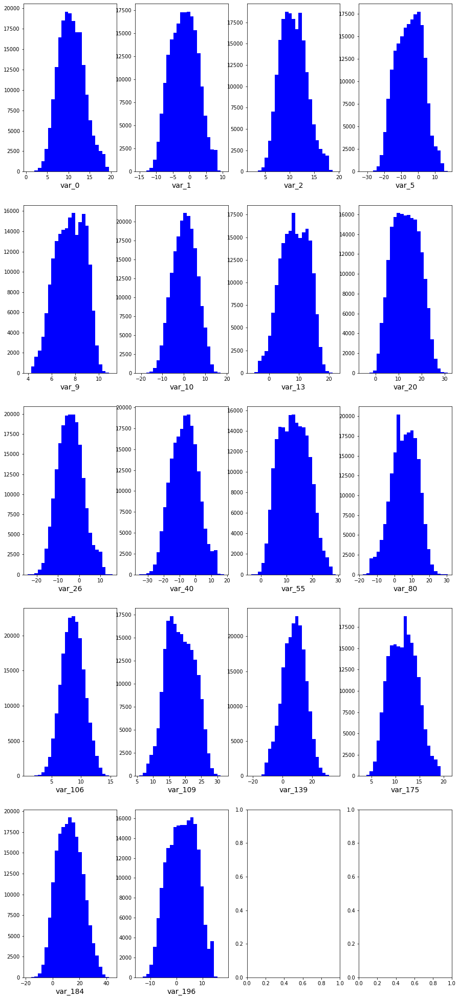

In [14]:
fig, axes = plt.subplots(5, 4, figsize=(15, 35))

for num, feature in enumerate(continuous_feature):
    data = train[feature].copy()
    axes[num//4, num%4].hist(data, bins=25, color="blue")
    axes[num//4, num%4].set_xlabel(feature, fontsize=14)

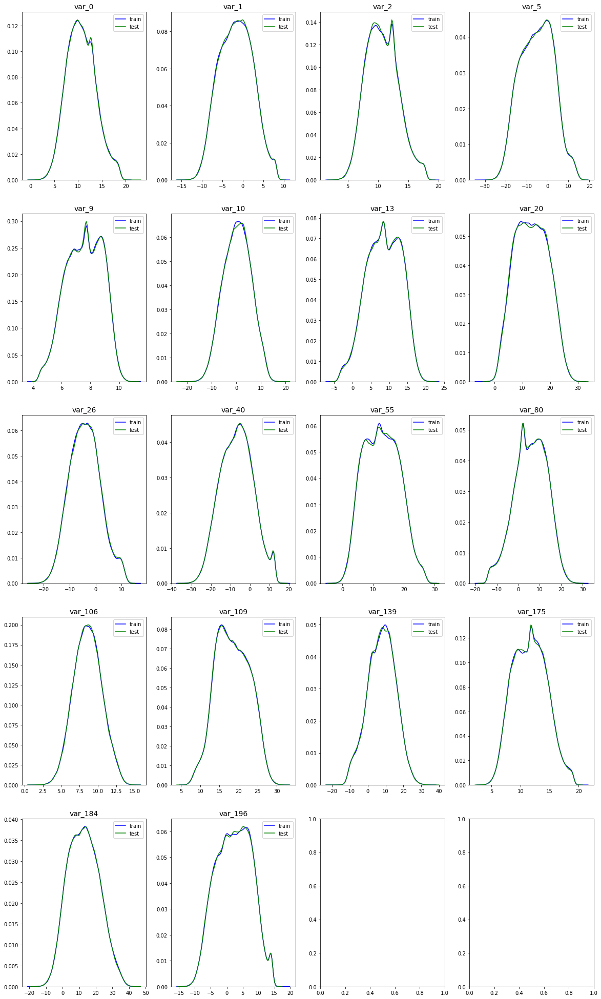

In [15]:
fig, axes = plt.subplots(5, 4, figsize=(20, 35))

for num, feature in enumerate(continuous_feature):
    try:
        train_data, test_data = train[feature].copy(), test[feature].copy()
        sns.kdeplot(train_data, ax=axes[num//4, num%4], color="blue", label="train")
        sns.kdeplot(test_data, ax=axes[num//4, num%4], color="green", label="test")
    except RuntimeError:
        pass
    except KeyError:
        train_data = train[feature].copy()
        sns.kdeplot(train_data, ax=axes[num//4, num%4], color="blue", label="train")
    axes[num//4, num%4].set_title(feature, fontsize=14)

## Категориальные признаки

In [16]:
categorical_features = train.select_dtypes(include=[np.object])
print(f"Categorical Feature Count {categorical_features.shape[1]}")
categorical_features.head(n=2)

Categorical Feature Count 0


""
0
1


## Анализ пропусков

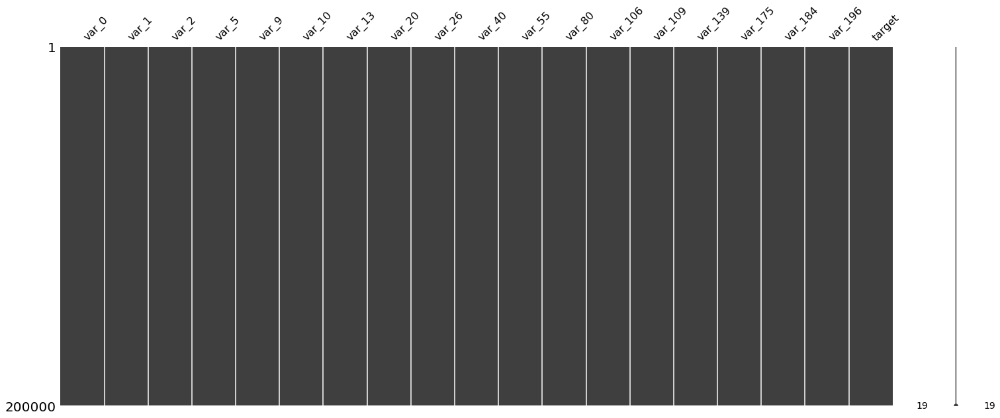

In [17]:
msno.matrix(train)

Пропусков нет

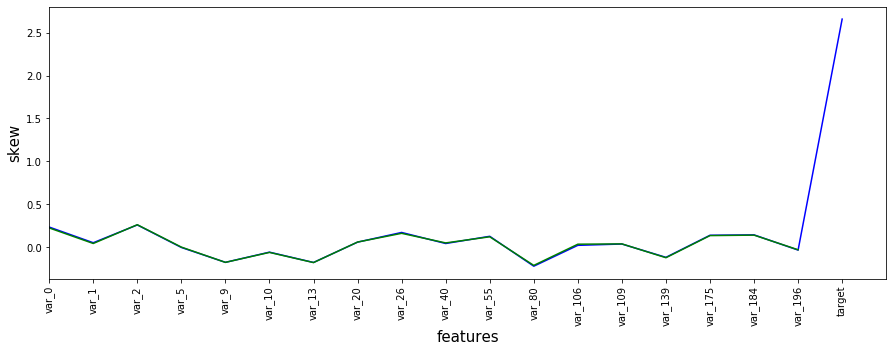

In [18]:
fig = plt.figure(figsize=(15, 5))
train_stats, test_stats = train.skew(), test.skew()
plt.plot(train_stats, color="blue", label="train")
plt.plot(test_stats, color="green", label="test")
plt.xticks(range(train_stats.shape[0]), train_stats.index, rotation=90)
plt.xlabel("features", size=15)
plt.xlim(0, len(train_stats))
plt.ylabel("skew", size=15)
plt.show()

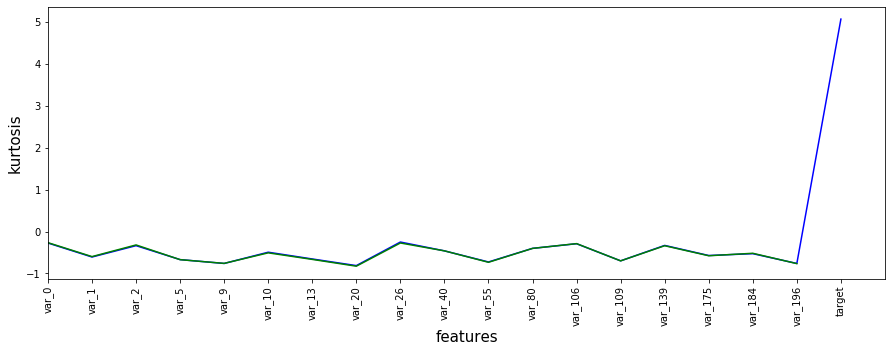

In [19]:
fig = plt.figure(figsize=(15, 5))
train_stats, test_stats = train.kurtosis(), test.kurtosis()
plt.plot(train_stats, color="blue", label="train")
plt.plot(test_stats, color="green", label="test")
plt.xticks(range(train_stats.shape[0]), train_stats.index, rotation=90)
plt.xlabel("features", size=15)
plt.ylabel("kurtosis", size=15)
plt.xlim(0, len(train_stats))
plt.show()

## Анализ распределения целевой переменной

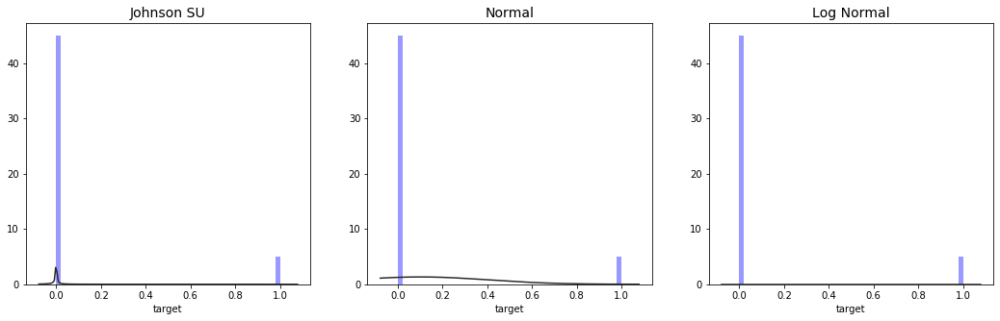

In [20]:
target = train["target"]
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

axes[0].set_title("Johnson SU", fontsize=14)
sns.distplot(target, kde=False, color="blue", fit=st.johnsonsu, ax=axes[0])

axes[1].set_title("Normal", fontsize=14)
sns.distplot(target, kde=False, color="blue", fit=st.norm, ax=axes[1])

axes[2].set_title("Log Normal", fontsize=14)
sns.distplot(target, kde=False, color="blue", fit=st.lognorm, ax=axes[2])

## Корреляция между числовыми признаками

In [21]:
correlation = numerical_features.corr()
corr_with_target = correlation["target"].sort_values(ascending = False)
corr_with_target

target     1.000000
var_26     0.062422
var_2      0.055870
var_0      0.052390
var_1      0.050343
var_40     0.049530
var_184    0.048315
var_106    0.032947
var_5      0.030979
var_196    0.023608
var_175    0.021692
var_55     0.017176
var_10    -0.002213
var_20    -0.018329
var_9     -0.042805
var_109   -0.049926
var_13    -0.055156
var_80    -0.057609
var_139   -0.074080
Name: target, dtype: float64

Text(0, 0.5, 'Density')

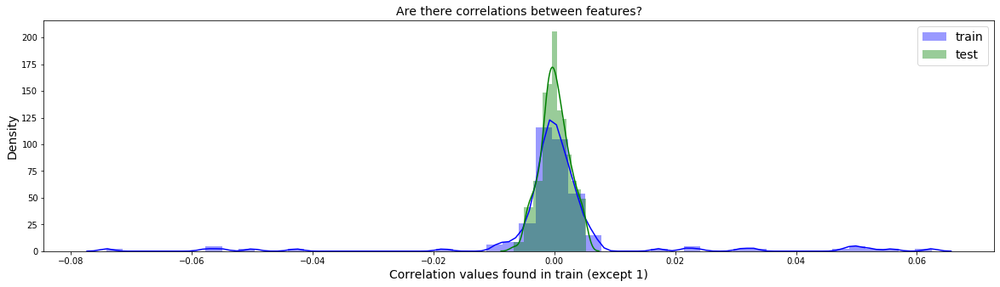

In [22]:
train_correlations = numerical_features.corr()
train_correlations = train_correlations.values.flatten()
train_correlations = train_correlations[train_correlations != 1]

columns = numerical_features.columns.tolist()
columns.remove("target")

test_correlations = test[columns].corr()
test_correlations = test_correlations.values.flatten()
test_correlations = test_correlations[test_correlations != 1]

plt.figure(figsize=(20,5))
sns.distplot(train_correlations, color="Blue", label="train")
sns.distplot(test_correlations, color="Green", label="test")

plt.xlabel("Correlation values found in train (except 1)", size=14)
plt.title("Are there correlations between features?", size=14)
plt.legend(loc="best", fontsize=14)
plt.ylabel("Density", size=14)

## Correlation Heat Map

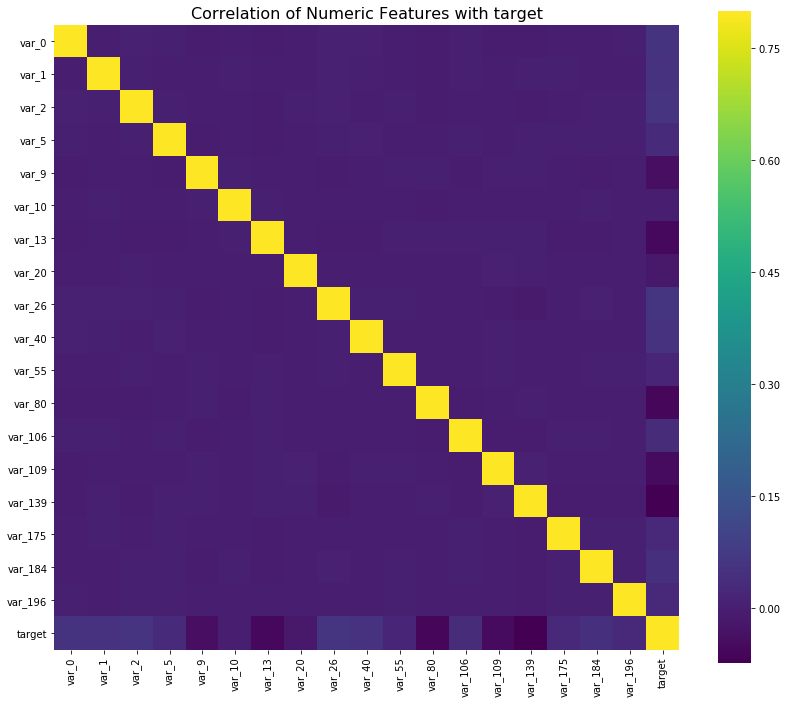

In [23]:
fig, axes = plt.subplots(figsize = (14,12))
plt.title("Correlation of Numeric Features with target", y=1, size=16)
sns.heatmap(correlation, square=True, vmax=0.8, cmap="viridis")

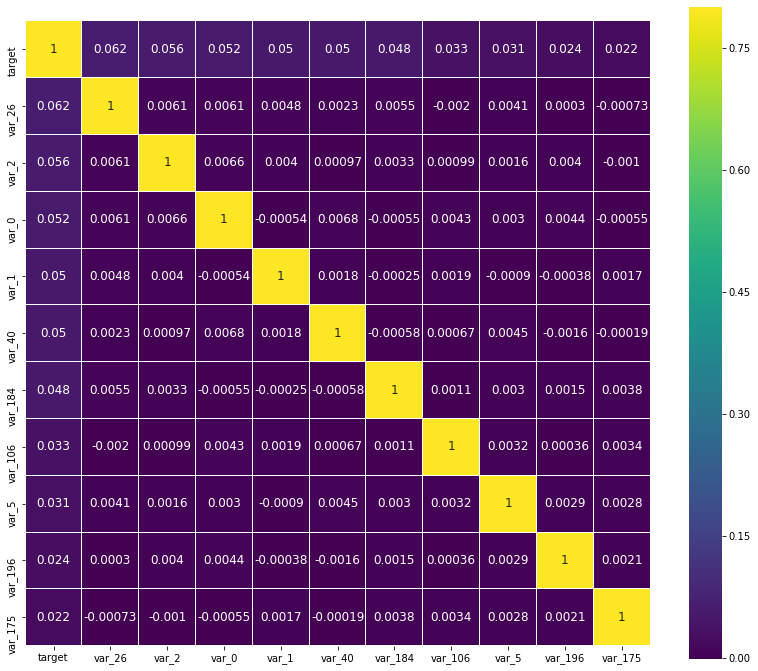

In [24]:
k = 11
cols = correlation.nlargest(k, "target")["target"].index
cm = np.corrcoef(train[cols].values.T)
fig, axes = plt.subplots(figsize = (14, 12))

sns.heatmap(
    cm,
    vmax=.8,
    linewidths=0.01,
    cmap="viridis",
    square=True,
    annot=True,
    linecolor="white",
    xticklabels=cols.values,
    annot_kws = {"size": 12},
    yticklabels=cols.values
)

## Нелинейная связь между признаками

In [25]:
%%time
parameters = {"max_depth": 6, "n_estimators": 25, "random_state": 27, "n_jobs": 2}

forest = RandomForestRegressor(**parameters)
forest.fit(numerical_features.fillna(-9999).drop("target", axis=1), target)

CPU times: user 28.7 s, sys: 310 µs, total: 28.7 s
Wall time: 14.9 s


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=6,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=25, n_jobs=2,
                      oob_score=False, random_state=27, verbose=0,
                      warm_start=False)

Text(0.5, 1.0, 'What are the top important features to start with?')

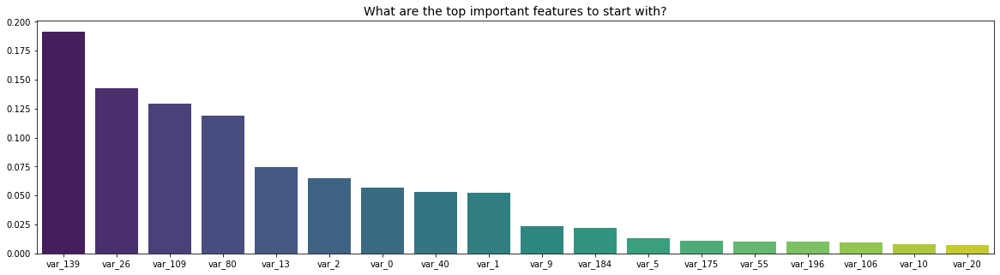

In [26]:
n_top = 20
importances = forest.feature_importances_
idx = np.argsort(importances)[::-1][0:n_top]
feature_names = numerical_features.drop("target", axis=1).columns

plt.figure(figsize=(20, 5))
sns.barplot(x=feature_names[idx], y=importances[idx], palette="viridis")
plt.title("What are the top important features to start with?", size=14)

## Pair Plot

/home/bocharick/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2065: UserWarning: The `size` parameter has been renamed to `height`; pleaes update your code.
  warnings.warn(msg, UserWarning)


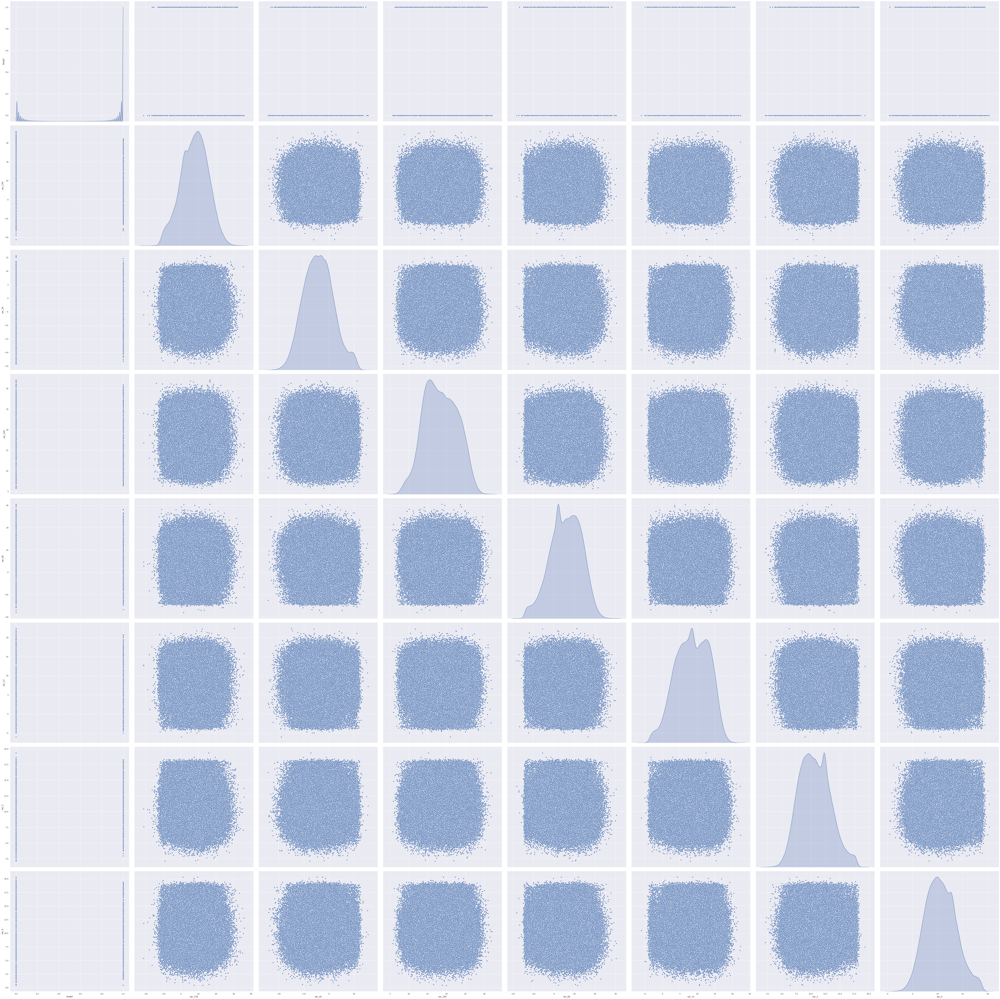

In [27]:
sns.set()
columns = [
    "target",
    "var_139",
    "var_26",
    "var_109",
    "var_80",
    "var_13",
    "var_2",
    "var_0"
]

sns.pairplot(train[columns], size=10, kind="scatter", diag_kind="kde")
plt.show()

## Scatter Plot

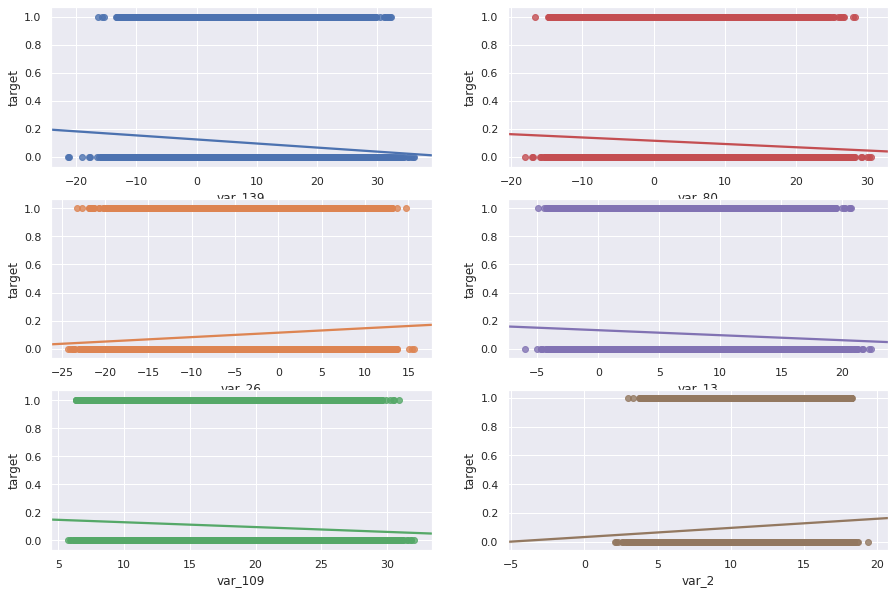

In [28]:
features = [
    "var_139",
    "var_26",
    "var_109",
    "var_80",
    "var_13",
    "var_2"
]

fig, axes = plt.subplots(3, 2, figsize=(15, 10))
for num, feature in enumerate(features):
    sns.regplot(
        x=feature,
        y="target",
        data=train,
        ax=axes[num%3, num//3],
        scatter=True,
        fit_reg=True
    )

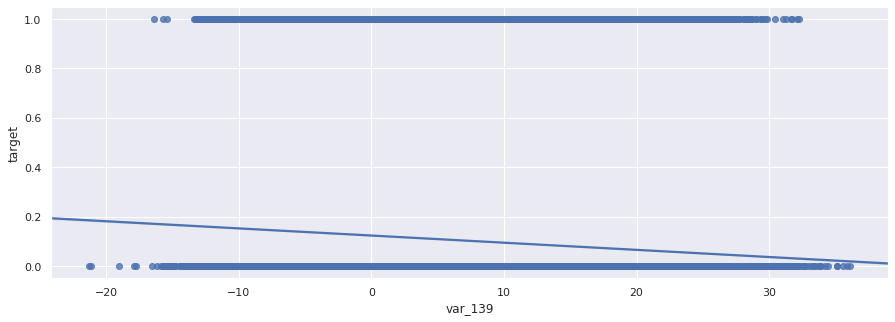

In [29]:
data = train[["var_139", "target"]]
data = data.sort_values(by="var_139").reset_index(drop=True)
fig, axes = plt.subplots(1, 1, figsize=(15, 5))

sns.regplot(
    x="var_139",
    y="target",
    data=data,
    ax=axes
)

## Анализ распределения на обучении и тесте

## Population Stability Index

In [30]:
class PSI(BaseEstimator, TransformerMixin):
    """
    Вычисление PSI и отбор признаков на их основе.

    Parameters
    ----------
    threshold: float
        Порог для отбора переменных по PSI.
        Если PSI для переменной выше порога - переменная макрируется
        0 (не использовать для дальнейшего анализа), если ниже
        порога - маркируется 1 (использовать для дальнейшего анализа).

    categorical_features: List[str], optional, default = None
        Список категориальных признаков для анализа.
        Опциональный параметр, по умолчанию, не используется, т.е.
        категориальные признаки отсутствуют.

    n_bins: int, optional, default = 20
        Количество бинов, на которые разбивается выборка.

    min_value: float, optional, default = 0.005
        Значение которое используется, если рассчитанный psi = 0.

    bin_type: string, optional, default = "quanitles"
        Способ разбиения на бины: "quantiles" or "bins".
        При выборе "quantiles" - выборка будет разбита на n_bins
        квантилей, при выборке "bins" - выборка будет разбита на
        n_bins бакетов с равным шагом между бакетами.
        Иные значения приводят к возникновению ValueError.

    Attributes
    ----------
    scores_: Dict[str, float]
        Словарь со значениями PSI,
        ключ словаря - название признака, значение - PSI-score.

    """
    def __init__(self,
                 threshold: float,
                 categorical_features: Optional[List[str]] = None,
                 bin_type: str = "quantiles",
                 min_value: float = 0.005,
                 n_bins: int = 20):

        self.threshold = threshold
        self.categorical_features = categorical_features
        self.min_value = min_value
        self.n_bins = n_bins
        if bin_type in ["quantiles", "bins"]:
            self.bin_type = bin_type
        else:
            raise ValueError(
                "Incorrect bin_type value. Expected 'quantiles' or 'bins', "
                f"but {bin_type} is transferred."
            )
        self.scores = {}

    def calculate_bins(self, data: pd.Series) -> np.array:
        """
        Вычисление границ бинов для разбиения выборки.

        Parameters
        ----------
        data: pandas.Series, shape = [n_samples, ]
            наблюдения из train-выборки.

        Returns
        -------
        bins: numpy.array, shape = [self.n_bins + 1]
            Список с границами бинов.

        """
        if self.bin_type == "quantiles":
            bins = np.linspace(0, 100, self.n_bins + 1)
            bins = [np.nanpercentile(data, x) for x in bins]

        else:
            bins = np.linspace(data.min(), data.max(), self.n_bins + 1)

        return np.unique(bins)

    def calculate_psi_in_bin(self, expected_score, actual_score) -> float:
        """
        Вычисление значения psi для одного бакета.

        Осуществляется проверка на равенство нулю expected_score и
        actual_score: если один из аргументов равен нулю, то его
        значение заменяется на self.min_value.

        Parameters
        ----------
        expected_score: float
            Ожидаемое значение.

        actual_score: float
            Наблюдаемое значение.

        Returns
        -------
        value: float
            Значение psi в бине.

        """
        if expected_score == 0:
            expected_score = self.min_value
        if actual_score == 0:
            actual_score = self.min_value

        value = (expected_score - actual_score)
        value = value * np.log(expected_score / actual_score)

        return value

    def calculate_psi(self, expected: pd.Series, actual: pd.Series, bins) -> float:
        """
        Расчет PSI для одной переменной.

        Parameters
        ----------
        expected: pandas.Series, shape = [n_samples_e, ]
            Наблюдения из train-выборки.

        actual: pandas.Series, shape = [n_samples_o, ]
            Наблюдения из test-выборки.

        bins: pandas.Series, shape = [self.n_bins, ]
            Бины для расчета PSI.

        Returns
        -------
        psi_score: float
            PSI-значение для данной пары выборок.

        """
        expected_score = np.histogram(expected.fillna(-9999), bins)[0]
        expected_score = expected_score / expected.shape[0]

        actual_score = np.histogram(actual.fillna(-9999), bins)[0]
        actual_score = actual_score / actual.shape[0]

        psi_score = np.sum(
            self.calculate_psi_in_bin(exp_score, act_score)
            for exp_score, act_score in zip(expected_score, actual_score)
        )

        return psi_score

    def calculate_numeric_psi(self, expected: pd.Series, actual: pd.Series) -> float:
        """
        Вычисление PSI для числовой переменной.

        Parameters
        ----------
        expected: pandas.Series, shape = [n_samples_e, ]
            Наблюдения из train-выборки.

        actual: pandas.Series, shape = [n_samples_o, ]
            Наблюдения из test-выборки.

        Returns
        -------
        psi_score: float
            PSI-значение для данной пары выборок.

        """
        bins = self.calculate_bins(expected)
        psi_score = self.calculate_psi(expected, actual, bins)
        return psi_score

    def calculate_categorical_psi(self, expected: pd.Series, actual: pd.Series) -> float:
        """
        Вычисление PSI для категориальной переменной.
        PSI рассчитывается для каждого уникального значения категории.

        Parameters
        ----------
        expected: pandas.Series, shape = [n_samples_e, ]
            Наблюдения из train-выборки.

        actual: pandas.Series, shape = [n_samples_o, ]
            Наблюдения из test-выборки.

        Returns
        -------
        psi_score: float
            PSI-значение для данной пары выборок.

        """
        bins = np.unique(expected).tolist()
        psi_score = self.calculate_psi(expected, actual, bins)
        return psi_score

    def fit(self, X, y=None):
        """
        Вычисление PSI-значения для всех признаков.

        Parameters
        ----------
        X: pandas.DataFrame, shape = [n_samples, n_features]
            Матрица признаков для обучения.

        y: pandas.DataFrame, shape = [n_samples, n_features]
            Матрица признаков для тестирования.

        Returns
        -------
        self
        """
        missed_columns = list(set(X.columns) - set(y.columns))

        if missed_columns:
            raise MissedColumnError(
                f"Missed {list(missed_columns)} columns in data.")

        if self.categorical_features:
            numeric_features = list(
                set(X.columns) - set(self.categorical_features)
            )
            for feature in self.categorical_features:
                self.scores[feature] = self.calculate_categorical_psi(
                    X[feature], y[feature]
                )
        else:
            numeric_features = X.columns

        for feature in tqdm(numeric_features):
            self.scores[feature] = self.calculate_numeric_psi(
                X[feature], y[feature]
            )
        return self

    def transform(self, X, y=None) -> pd.DataFrame:
        """
        Отбор переменных по self.threshold.
        Если PSI-score для переменной выше порога, то переменная
        помечается 0 (не использовать для дальнейшего анализа), если ниже
        порога - маркируется 1 (использовать для дальнейшего анализа).

        Parameters
        ----------
        data: pandas.DataFrame, shape = [n_samples, n_features]
            Матрица признаков для обучения.

        target: pandas.DataFrame, shape = [n_samples, n_features]
            Матрица признаков для тестирования.

        Returns
        -------
        scores: pandas.DataFrame, shape = [n_features, 3]
            Датафрейм с PSI-анализом переменных.

        """
        check_is_fitted(self, "scores")
        scores = pd.Series(self.scores)
        scores = pd.DataFrame({"Variable": scores.index, "PSI": scores.values})
        scores["Selected"] = np.where(scores.PSI < self.threshold, 1, 0)
        scores = scores.sort_values(by="PSI")

        mask = scores["Selected"] == 1
        self.used_features = scores.loc[mask, "Variable"].tolist()

        return scores.reset_index(drop=True)

In [31]:
features_to_score = numerical_features.drop(["target"], axis=1).columns.tolist()
psi = PSI(threshold=0.01)

In [32]:
psi.fit_transform(
    X=train[features_to_score],
    y=test[features_to_score]
)

100%|██████████| 18/18 [00:00<00:00, 18.78it/s]


,Variable,PSI,Selected
0,var_5,0.000138,1
1,var_196,0.000198,1
2,var_184,0.000203,1
3,var_40,0.000204,1
4,var_13,0.000207,1
5,var_109,0.000222,1
6,var_175,0.000228,1
7,var_9,0.000229,1
8,var_55,0.000235,1
9,var_1,0.000240,1


## Adversarial Validation

In [33]:
X_adv = pd.concat([
    train[features_to_score], test[features_to_score]
])
y_adv = np.hstack(
    (np.ones(train.shape[0]), np.zeros(test.shape[0])))

X_adv = X_adv.reset_index(drop=True)

In [34]:
%%time
parameters = {"max_depth": 4, "n_estimators": 50, "random_state": 27, "n_jobs": 2}
model = xgb.XGBClassifier(**parameters)

cv = cross_val_score(
    estimator=model,
    X=X_adv, y=y_adv,
    scoring="roc_auc",
    cv=KFold(n_splits=3, shuffle=True, random_state=27)
)

print(f"CV-score: {round(np.mean(cv), 4)}")

CV-score: 0.5105
CPU times: user 46 s, sys: 88.2 ms, total: 46.1 s
Wall time: 23.1 s


Text(0.5, 1.0, 'Top Importance Features for Adversarial Validation (train vs test)')

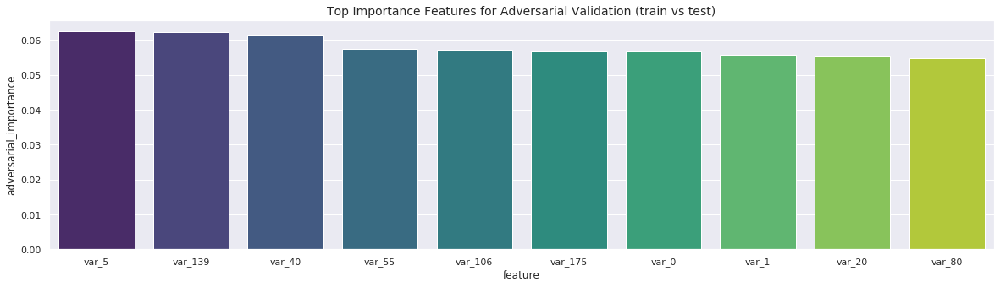

In [35]:
model.fit(X_adv, y_adv)

importance = pd.DataFrame({
    "feature": X_adv.columns,
    "adversarial_importance": model.feature_importances_
})
importance = importance.sort_values(by="adversarial_importance", ascending=False)
importance = importance.head(n=10)

plt.figure(figsize=(20, 5))
sns.barplot(x=importance["feature"], y=importance["adversarial_importance"], palette="viridis")
plt.title("Top Importance Features for Adversarial Validation (train vs test)", size=14)